In [1]:
# required to prepare data for altair plot
import pandas as pd

# required for altair plot
import altair as alt
import numpy as np

Prepare data.

In [2]:
# I don't even have to bother with the SQL database, just get data from a .csv file
df = pd.read_csv(r'D:\data science\nutrition\data\recipes_sql_28082020.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36290 entries, 0 to 36289
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   recipesID            36290 non-null  int64  
 1   title                36290 non-null  object 
 2   ingredients          36285 non-null  object 
 3   categories           35578 non-null  object 
 4   date                 36290 non-null  object 
 5   rating               36290 non-null  float64
 6   calories             27928 non-null  float64
 7   sodium               27928 non-null  float64
 8   fat                  27927 non-null  float64
 9   protein              27927 non-null  float64
 10  ghg                  36290 non-null  float64
 11  prop_ing             36288 non-null  float64
 12  ghg_log10            36290 non-null  float64
 13  url                  36290 non-null  object 
 14  servings             34934 non-null  object 
 15  index                36290 non-null 

In [4]:
# determine some reference recipes (randomly)
df_ref = df.loc[df.recipesID.isin([123,1253,13546,12343,12,1,142,12323,49,9382,394,382,393,74,384,3928,4859,8739]),:]
df_ref.head()

,recipesID,title,ingredients,categories,date,rating,calories,sodium,fat,protein,ghg,prop_ing,ghg_log10,url,servings,index,image_url,perc_rating,perc_sustainability,review_count
183,1,Triple-Threat Onion Galette,1 tbsp. sugar;1½ tsp. diamond crystal or 1 tsp...,bon appétit;bake;dinner;lunch;brunch;vegetaria...,2020-05-15T20:53:41.255Z,0.000,3708.0,4504.0,265.0,136.0,1.466289,0.692308,0.166219,triple-threat-onion-galette,makes;one;12-diameter;galette,1,https://assets.epicurious.com/photos/5eaa0c4e6...,0,77,1.0
218,12,Green-Garlic-Rubbed Buttery Roast Chicken,"1 (3½–4-lb.) whole chicken, patted dry;kosher...",bon appétit;dinner;roast;poultry;chicken;garli...,2020-05-18T13:52:58.382Z,0.000,969.0,1215.0,75.0,57.0,4.618584,1.000000,0.664509,green-garlic-rubbed-buttery-roast-chicken,4;servings,12,https://assets.epicurious.com/photos/5ebc7d886...,0,39,NaN
329,49,Beans and Greens Polenta Bake,3 cups still-warm big-batch parmesan polenta;6...,garlic;olive oil;kale;vinegar;parmesan;dinner;...,2020-04-13T03:21:46.027Z,4.375,741.0,279.0,19.0,22.0,3.831712,0.888889,0.583393,beans-and-greens-polenta-bake,4;servings,49,https://assets.epicurious.com/photos/5e8f5388a...,88,47,7.0
360,74,One-Pot Gingery Chicken and Rice With Peanut S...,"6 small skin-on, bone-in chicken thighs (about...",bon appétit;dinner;one-pot meal;chicken;rice;g...,2020-03-18T20:20:28.733Z,4.375,767.0,819.0,38.0,38.0,7.311586,1.000000,0.864012,one-pot-gingery-chicken-and-rice-with-peanut-s...,6;servings,74,https://assets.epicurious.com/photos/5e67e496a...,88,21,19.0
411,123,Cauliflower Bolognese,"12 oz. mushrooms, such as shiitake or crimini,...",bon appétit;dinner;cauliflower;pasta;mushroom;...,2020-02-14T20:18:18.722Z,3.750,656.0,930.0,30.0,25.0,1.666798,0.785714,0.221883,cauliflower-bolognese-pasta,6;servings,123,https://assets.epicurious.com/photos/5e459ce19...,75,74,12.0


In [5]:
df.columns

Index(['recipesID', 'title', 'ingredients', 'categories', 'date', 'rating',
       'calories', 'sodium', 'fat', 'protein', 'ghg', 'prop_ing', 'ghg_log10',
       'url', 'servings', 'index', 'image_url', 'perc_rating',
       'perc_sustainability', 'review_count'],
      dtype='object')

In [6]:
'''Linear scale emissions dataframe'''

# prepare data for histograms_emissions
ref_emissions = df_ref['ghg'].values
all_emissions = df['ghg'].values
ref_urls = df_ref['url'].values
ref_titles = df_ref['title'].values

# altair likes dataframes, so create new dataframe where we dummy code reference recipes (yes or no)
ref_dummy = df.recipesID.isin([123,1253,13546,12343,12,1,142,12323,49,9382,394,382,393,74,384,3928,4859,8739])
df_hist = pd.DataFrame({'Emissions': df['ghg'], 
                        'url': df['url'], 
                        'Title': df['title'],
                        'reference': ref_dummy})



'''Same but for log-scale emissinos'''

ref_emissions_log = df_ref['ghg_log10'].values
all_emissions_log = df['ghg_log10'].values
df_hist_log = pd.DataFrame({'log10(Emissions)': df['ghg_log10'],
                        'Emissions': df['ghg'],
                        'url': df['url'], 
                        'Title': df['title'],
                        'reference': ref_dummy})


In [7]:
# subselect items with emissions > 0
print(sum(df_hist['Emissions'] == 0))
df_hist['Emissions'].replace(to_replace=0, value=0.01, inplace=True)

19


In [8]:
print(sum(df_hist['Emissions'] == 0))
print(sum(df_hist['Emissions'] < 0))

0
0


In [9]:
df_hist.loc[df_hist['reference'],:]

,Emissions,url,Title,reference
183,1.466289,triple-threat-onion-galette,Triple-Threat Onion Galette,True
218,4.618584,green-garlic-rubbed-buttery-roast-chicken,Green-Garlic-Rubbed Buttery Roast Chicken,True
329,3.831712,beans-and-greens-polenta-bake,Beans and Greens Polenta Bake,True
360,7.311586,one-pot-gingery-chicken-and-rice-with-peanut-s...,One-Pot Gingery Chicken and Rice With Peanut S...,True
411,1.666798,cauliflower-bolognese-pasta,Cauliflower Bolognese,True
430,0.623817,steamed-kabocha-squash-with-ginger-soy-dressing,Steamed Kabocha With Ginger-Soy Dressing,True
685,7.981290,all-day-every-day-yogurt-sauce,All Day Every Day Sauce,True
686,2.629549,roasted-red-pepper-frittata,Roasted Red Pepper Frittata,True
697,2.833933,perfect-pesto-pasta,Perfect Pesto Pasta,True
698,47.587740,double-stack-smash-burger-alfresco-with-cheese,Smash Burger Alfresco,True


In [10]:
df_hist

,Emissions,url,Title,reference
0,2.186879,creamy-corn-studded-polenta-242149,Creamy Corn-Studded Polenta,False
1,8.099507,coconut-and-ricotta-pancakes-with-ginger-syrup...,Coconut and Ricotta Pancakes with Ginger Syrup,False
2,4.540354,fish-and-vegetable-bstillas-242143,Fish and Vegetable B'stillas,False
3,4.026741,pappardelle-with-mushrooms-and-tomato-cream-sa...,Pappardelle with Mushrooms and Tomato Cream Sauce,False
4,0.190552,carrot-salad-with-lime-and-cilantro-101512,Carrot Salad with Lime and Cilantro,False
...,...,...,...,...
36285,6.553231,-tuna-of-chicken-13224,Tuna of Chicken,False
36286,3.960254,roast-chicken-with-orange-lemon-and-ginger-15413,"Roast Chicken with Orange, Lemon, and Ginger",False
36287,5.186192,jennie-junes-brown-fricassee-chicken-40018,Jennie June's Brown Fricassée Chicken,False
36288,5.128961,portobello-mushroom-salad-a-la-grecque-recipe,Portobello Mushroom Salad à la Grecque,False


In [11]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

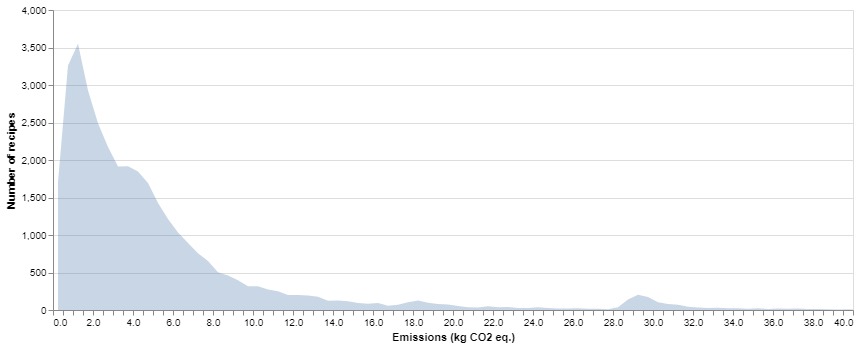

In [12]:
source = df_hist

# Linear scaling, zoomed in to 0 to 40 kg CO2
alt.Chart(source).mark_area(
    opacity=0.3,
    ).encode(
    alt.X("Emissions:Q",
          axis=alt.Axis(title='Emissions (kg CO2 eq.)'),
          scale=alt.Scale(type='linear', domain=(0, 40)),
          bin=alt.BinParams(maxbins=1000),
         ),
    alt.Y('count(*):Q', 
          axis=alt.Axis(title='Number of recipes'),
          stack=None)
).properties(width=800, height=300).interactive()

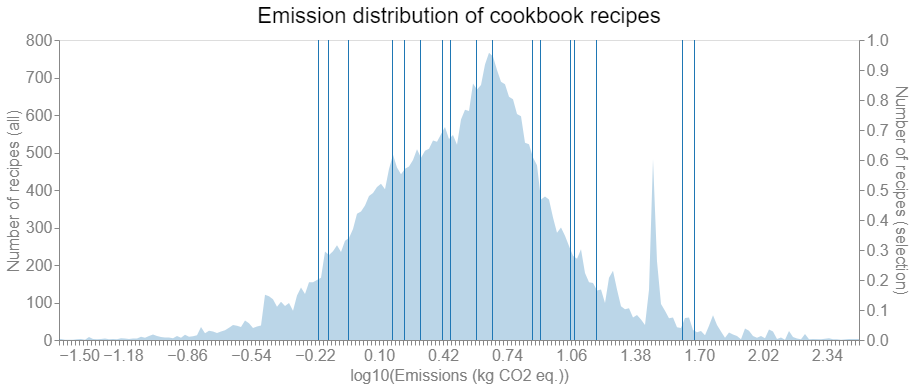

In [13]:
# input arguments
Title = 'Emission distribution of cookbook recipes'
data = df_hist_log
col = '#1f77b4'

# background chart
source = data
bg_chart = alt.Chart(source).mark_area(color=col,
                opacity=0.3,
             ).encode(
                alt.X("log10(Emissions):Q",
                      axis=alt.Axis(title='log10(Emissions (kg CO2 eq.))'),
                      scale=alt.Scale(type='linear', domain=(-1.5, 2.5)),
                      bin=alt.BinParams(maxbins=300),
                     ),
                alt.Y('count(*):Q', 
                      axis=alt.Axis(title='Number of recipes (all)'),
                      stack=None
                     ),
             ).properties(
                width=800, 
                height=300,
                title=Title
             )

# foreground chart - e.g. cookbook recipes
source = data.loc[data['reference'],:]
fg_chart = alt.Chart(source).mark_bar(color=col
             ).encode(
                x=alt.X("log10(Emissions):Q",
                        scale=alt.Scale(type='linear', domain=(-1.5, 2.5)),
                        bin=alt.BinParams(maxbins=300),
                       ),
                y=alt.Y('count(*):Q', 
                        axis=alt.Axis(title='Number of recipes (selection)'),
                        stack=None
                       ),
                tooltip=['Title', 'Emissions'],
                href='link:N',
             ).properties(width=800, height=300).interactive()

# Set different y-axes for background and foreground
full_chart = alt.layer(bg_chart, fg_chart).resolve_scale(
    y = 'independent'
)

full_chart.configure_axis(
        labelFontSize=16,
        titleFontSize=16,
        labelFontWeight='normal',
        titleFontWeight='normal',
        labelColor='gray',
        titleColor='gray',
    ).configure_title(
        fontSize=22,
        fontWeight='normal')

In [17]:
def histogram_emissions(data, title):
    '''
    DESCRIPTION:
        Creates a histogram of emission scores of a list of reference
        recipes, with the distribution of all emission scores as the
        background.

    INPUT:
        data (pandas.DataFrame): With columns
            Emissions (Float): log10-scaled emission scores
            url (String): recipe url (e.g. "pineapple-shrimp-noodles")
            Title (String): recipe title (e.g. "Pineapple shrimp noodles")
            reference (boolean): True for all reference recipes to highlight
        title (String): Figure title

    OUTPUT:
        Altair json object
    '''
    col = '#1f77b4'

    # background chart
    source = data
    bg_chart = alt.Chart(source).mark_area(color=col,
                    opacity=0.3,
                 ).encode(
                    alt.X("log10(Emissions):Q",
                          axis=alt.Axis(title='log10(Emissions (kg CO2 eq.))'),
                          scale=alt.Scale(type='linear', domain=(-1.5, 2.5)),
                          bin=alt.BinParams(maxbins=300),
                         ),
                    alt.Y('count(*):Q', 
                          axis=alt.Axis(title='Number of recipes (all)'),
                          stack=None
                         ),
                 ).properties(
                    width=800, 
                    height=300,
                    title=Title
                 )

    # foreground chart - e.g. cookbook recipes
    source = data.loc[data['reference'],:]
    fg_chart = alt.Chart(source).mark_bar(color=col
                 ).encode(
                    x=alt.X("log10(Emissions):Q",
                            scale=alt.Scale(type='linear', domain=(-1.5, 2.5)),
                            bin=alt.BinParams(maxbins=300),
                           ),
                    y=alt.Y('count(*):Q', 
                            axis=alt.Axis(title='Number of recipes (selection)'),
                            stack=None
                           ),
                    tooltip=['Title', 'Emissions'],
                    href='link:N',
                 ).properties(width=800, height=300).interactive()

    # Set different y-axes for background and foreground
    full_chart = alt.layer(bg_chart, fg_chart).resolve_scale(
        y = 'independent'
    ).configure_axis(
        labelFontSize=16,
        titleFontSize=16,
        labelFontWeight='normal',
        titleFontWeight='normal',
        labelColor='gray',
        titleColor='gray',
    ).configure_title(
        fontSize=22,
        fontWeight='normal'
    )

    # Return .json of chart
    return full_chart  #.to_json()

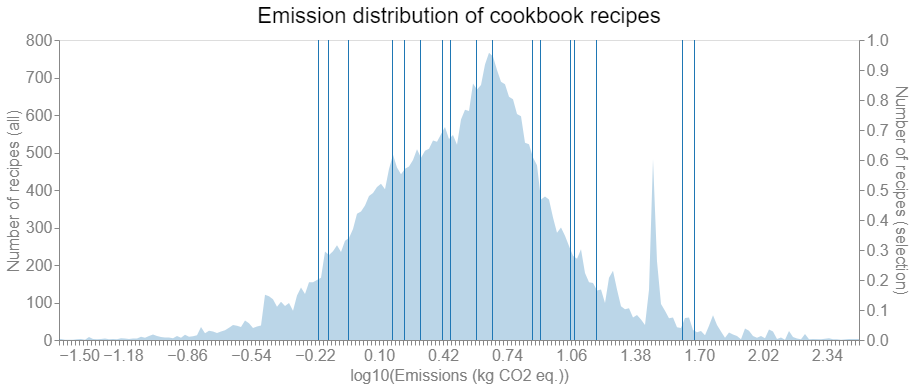

In [18]:
# input arguments
Title = 'Emission distribution of cookbook recipes'
data = df_hist_log

histogram_emissions(data, Title)

### results.html

Compare sustainability scores between the reference recipe and recipes with similar categories.

In [1]:
def bar_compare_emissions(reference_recipe, search_results, relative=True,
                          base_url='https://sustainable-recipe-recommender.herokuapp.com/search/',
                          sort_by='Similarity', scale='lin'):
    '''
    DESCRIPTION:
        Creates a bar chart of GHG emissions for the reference
        recipe and suggested similar recipes relative to the
        reference recipe.

    INPUT:
        reference_recipe (DataFrame): Recipe dataframe row for the
            reference recipe (to which everything else is compared)

        search_results (DataFrame): Recipe dataframe with rows being
            the suggested similar recipes to the reference recipe.

        relative (Boolean): If true, emission scores are relative to
            the reference recipe, otherwise absolute emissions are
            shown (default=True).

        base_url (String): Base url of the recipe search website

        sort_by (String): Url GET query by which to sort recipes
            (default=Similarity).

        scale (String): Can be 'lin' for linear scale, or 'log' for
            log-scale (default='lin')

    OUTPUT:
        Altair json object
    '''

    # determine scale
    if scale == 'log':
        voi = 'emissions_log10'
        xlabel = 'log10(kg CO2 eq)'
    else:
        voi = 'emissions'
        xlabel = 'kg CO2 eq'

    if relative:
        # compute emissions relative to reference
        source = search_results.copy()
        source['emission change'] = np.ceil(100*(
                                       search_results[voi].values -
                                       reference_recipe[voi]))/100
        source['emission_change'] = source['emission change']

        # create bar chart
        bars = alt.Chart(
            source
        ).transform_calculate(
            link=base_url + alt.datum.url + '?sort_by=' + sort_by
        ).mark_bar().encode(
            y=alt.Y("title:N", axis=alt.Axis(orient='right',
                                             title=' ',
                                             labels=True),
                    sort=list(range(source.shape[0]))
                    ),
            x=alt.X("emission_change:Q",
                    axis=alt.Axis(title=xlabel)
                    ),
            tooltip=['title', 'emission change'],
            href='link:N',
            color=alt.condition(
                alt.datum.emission_change > 0,
                alt.value("palevioletred"),  # The positive color
                alt.value("palegreen")  # The negative color
            )
        ).properties(
            width=250,
            height=500,
            title='Similar recipes'
        ).configure_axis(
            labelFontSize=16,
            titleFontSize=16,
            labelFontWeight='normal',
            titleFontWeight='normal',
            labelColor='gray',
            titleColor='gray',
        ).configure_title(
            fontSize=22,
            fontWeight='normal',
            anchor='start'
        ).interactive()

    else:
        # TODO option for plotting absolute emission scores
        pass

    # Return .json of chart
    return bars.to_json()

### profile.html (cookbook)

Overview of liked recipes, favorite categories, and emissions within cookbook and relative to all recipes